# Data loader example
## Import necessary libraries

In [1]:
import os
import coloredlogs, logging
import json
import math
import numpy as np
import scipy.io
import librosa # Version 0.8.1
import librosa.display
from tqdm.auto import tqdm
import IPython.display as ipd

from stl import mesh
from mpl_toolkits import mplot3d
from matplotlib.colors import LightSource

import torch
import torchaudio
import torch.nn as nn

## Constants
* Change the ```OUTPUT_FOLDER``` path to the folder containing the RIRs.
* Change the ```JSON_FILENAME``` to your desired metadata file. It's searched for in the ```OUTPUT_FOLDER```.
* The ```MATLAB_FILENAME``` contains additional information about the simulation. Here the first simulation run can be chosen. It's searched for in the ```OUTPUT_FOLDER```.
* Change the ```MODEL_3D``` to the one you selected as a database.

In [2]:
# Folder where the Database is saved (Folder "OUT" needs to be selected)
OUTPUT_FOLDER = '../database/OUT'
OUTPUT_FOLDER = "/mnt/nfs/Databases/ASN_Database_Custom_3.1_sorted/OUT"
# Name of the metadata JSON file
JSON_FILENAME = 'RIR.json'
# Name of one simulation scenario data file (there are multiple)
MATLAB_FILENAME = 'RIR_1.MAT'
# Name of logging file to be generated
LOG_FILE = 'log.txt'
# Path to 3D model (as STI) to use for plotting
MODEL_3D = 'other/3D_Models/ASN_empty.stl' # Use if room model chosen without humans
# MODEL_3D = 'other/3D_Models/ASN_humans.stl' # Use if room model chosen with humans
# Target sample rate signals are resampled to
FS = 48000
# Clean audio file for convolution
CLEAN_AUDIO = 'other/audio/speech.wav'

In [3]:
# example_folder = os.path.dirname(os.path.abspath(__file__))
example_folder = os.path.dirname(os.path.abspath("__file__"))
MODEL_3D = os.path.abspath(os.path.join(example_folder, f"../{MODEL_3D}"))
CLEAN_AUDIO = os.path.abspath(os.path.join(example_folder, f"../{CLEAN_AUDIO}"))

## Inits
Initializes logging and torchaudio for the WAV dataloader.

In [4]:
# Init Config
logging.basicConfig(
    level=logging.DEBUG,
    handlers=[
        logging.FileHandler(LOG_FILE),
        logging.StreamHandler()
    ])
logger = logging.getLogger(__name__)
coloredlogs.install(level='INFO', logger=logger, fmt='%(levelname)-8s %(message)s')

# Setup torchaudio
# To be compatible with future versions of torchaudio
torchaudio.USE_SOUNDFILE_LEGACY_INTERFACE = False
# Fixes problem with some WAV headers
torchaudio.set_audio_backend('soundfile')
# Use CUDA if available
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
# Get PyTorch and Torchaudio versions
logger.info('PyTorch version: ' + str(torch.__version__))
logger.info('Torchaudio version: ' + str(torchaudio.__version__))

INFO     PyTorch version: 1.12.1+cu102
INFO     Torchaudio version: 0.12.1+cu102


## Check if program is executed as notebook
Plotting is handled with regard to the used environment you are running this code.

In [5]:
def isnotebook():
    try:
        shell = get_ipython().__class__.__name__
        if shell == 'ZMQInteractiveShell':
            return True   # Jupyter notebook or qtconsole
        elif shell == 'TerminalInteractiveShell':
            return False  # Terminal running IPython
        else:
            return False  # Other type (?)
    except NameError:
        return False      # Probably standard Python interpreter

# Use WebAgg if no display is connected (e.g. ssh) and not running as notebook
import matplotlib
if (os.name == 'posix' and "DISPLAY" not in os.environ) and not isnotebook():
    matplotlib.use('WebAgg')
# Return used Matplotlib backend
logger.info('Matplotlib backend: ' + str(matplotlib.get_backend()))

import matplotlib.pyplot as plt

INFO     Matplotlib backend: module://matplotlib_inline.backend_inline


## Load JSON containing meta information

In [6]:
# To path
OUTPUT_FOLDER = os.path.abspath(OUTPUT_FOLDER)
logger.info('Loading database: ' + str(OUTPUT_FOLDER))

json_path = os.path.join(OUTPUT_FOLDER, JSON_FILENAME)
with open(json_path, 'r') as json_file:
    meta_data = json.loads(json_file.read())

INFO     Loading database: /mnt/nfs/Databases/ASN_Database_Custom_3.1_sorted/OUT


### Create node array
This part converts the metadata information, which contains one entry for each RIR, to a sorted dictionary.
Each entry in the dictionary contains all information for one node including the source information as well.

In [7]:
# Creates dictionary for each node in database from source pair information.

nodes = dict()
for room in tqdm(meta_data):
    for example in meta_data[room]:
        # If node already in dict
        if meta_data[room][example]['node_id'] in nodes.keys():
            # Add next source
            idx = len(node_source_pair['src'])
            node_source_pair['src'][idx] = {}
            node_source_pair['src'][idx]['src_id'] = meta_data[room][example]['src_id']
            node_source_pair['src'][idx]['rir_paths'] = {key: os.path.join(OUTPUT_FOLDER, value) for key, value in meta_data[room][example]['rir_paths'].items()}
            node_source_pair['src'][idx]['source_position'] = meta_data[room][example]['source_position']
        else:
            # Create entry for node with all information
            node_source_pair = dict()
            node_source_pair['node_id'] = meta_data[room][example]['node_id']
            node_source_pair['room'] = room
            node_source_pair['example'] = example
            node_source_pair['src'] = {}
            node_source_pair['src'][0] = {}
            node_source_pair['src'][0]['src_id'] = meta_data[room][example]['src_id']
            node_source_pair['src'][0]['rir_paths'] = {key: os.path.join(OUTPUT_FOLDER, value) for key, value in meta_data[room][example]['rir_paths'].items()}
            node_source_pair['src'][0]['source_position'] = meta_data[room][example]['source_position']
            node_source_pair['node_position'] = meta_data[room][example]['node_position']
            node_source_pair['node_orientation'] = meta_data[room][example]['node_orientation']
            mics_x = meta_data[room][example]['microphone_positions'][0]
            mics_y = meta_data[room][example]['microphone_positions'][1]
            mics_z = meta_data[room][example]['microphone_positions'][2]
            # Add microphone of node array to dict entry
            node_source_pair['rec'] = {}
            for mic_id, mic in enumerate(meta_data[room][example]['rir_paths']):
                node_source_pair['rec'][mic] = {}
                node_source_pair['rec'][mic] = [mics_x[mic_id], mics_y[mic_id], mics_z[mic_id]]
            nodes[node_source_pair['node_id']] = node_source_pair
        pass

  0%|          | 0/5 [00:00<?, ?it/s]

### Number of sources and receivers

In [8]:
logger.info('Number Receiver: ' + str(len(nodes)))
logger.info('Number Sources: ' + str(len(nodes[0]['src'])))

INFO     Number Receiver: 98
INFO     Number Sources: 202


### Load simulation environment information
Some prints of useful information from the simulation is given here.

In [9]:
# This information is created automatically by CATT-Acoustic's TUCT algorithm.
matlab_data_file = os.path.join(OUTPUT_FOLDER, MATLAB_FILENAME)
matlab_data = scipy.io.loadmat(matlab_data_file)

logger.info(f"Room volume: {matlab_data['room_volume'][0][0]}  $m^3$")
logger.info(f"Surface area: {matlab_data['room_surface_area'][0][0]}  $m^2$")
logger.info(f"Sound velocity: {matlab_data['soundvelocity'][0][0]}  $m/s$")
logger.info(f"Air temperature: {matlab_data['air_temperature'][0][0]}  °C")
logger.info(f"Air humidity: {matlab_data['air_humidity'][0][0]}  $\%$")
logger.info(f"Air density: {matlab_data['air_density'][0][0]}  $kg/m^3$")

INFO     Room volume: 103.21296691894531  $m^3$
INFO     Surface area: 285.98431396484375  $m^2$
INFO     Sound velocity: 343.32464599609375  $m/s$
INFO     Air temperature: 20.0  °C
INFO     Air humidity: 50.0  $\%$
INFO     Air density: 1.2000000476837158  $kg/m^3$


## Angle orientation
This plot shows how the rotation of each node is computed.

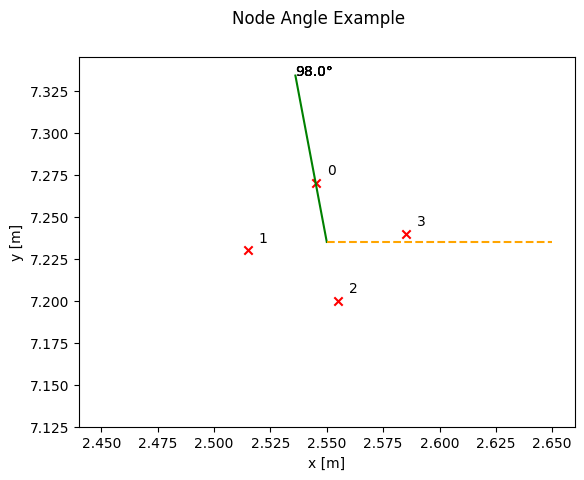

In [10]:
# This plot shows the microphones each node consists of with their numbering and angle computation.

# Create new figure
fig = plt.figure()
fig.suptitle("Node Angle Example")

# Use example from node dict
node = nodes[10]

# Add microphones from example node
plt.scatter(np.array(list(node['rec'].values()))[:,0], np.array(list(node['rec'].values()))[:,1], c='r', marker='x')
x = node['node_position'][0]
y = node['node_position'][1]
z = node['node_position'][2]

# Add line showing aim of microphone array from example node
LENGTH = 0.1
x_end = x + LENGTH * math.cos(node['node_orientation'])
y_end = y + LENGTH * math.sin(node['node_orientation'])
plt.plot([x, x_end], [y, y_end], c='g')

# Annotate microphones and angle
for rec, pos in enumerate(node['rec'].values()):
    plt.text(pos[0]+0.005, pos[1]+0.005, rec)
    plt.text(x_end, y_end, f"{math.degrees(node['node_orientation'])}°")

plt.plot([x, x+LENGTH], [y, y], z, c='orange', linestyle='dashed')
plt.xlim(x-0.11, x+0.11)
plt.ylim(y-0.11, y+0.11)
plt.xlabel('x [m]')
plt.ylabel('y [m]')
# plt.axis('equal')

# If notebook, show right away
if isnotebook():
    plt.show()
    plt.close()

## Plots of the room model with receiver nodes and sources

In [11]:
def plot_3d_model(model, dimention=2):
    # Create a new plot
    fig = plt.figure(figsize=(15,15))
    if dimention == 2:
        fig.suptitle("Top View Room Model")
        ax = fig.add_subplot(projection='3d')
        # Init view to YZ plane
        ax.view_init(azim=-90, elev=90)
    elif dimention == 3:
        fig.suptitle("3D Room Model")
        ax = mplot3d.Axes3D(fig, auto_add_to_figure=False)
        fig.add_axes(ax)
        # Add light source
        ls = LightSource(azdeg=225.0, altdeg=45.0)

    # Load the STL files and add the vectors to the plot
    room_mesh = mesh.Mesh.from_file(model)
    poly = mplot3d.art3d.Poly3DCollection(room_mesh.vectors)
    poly.set_alpha(0.4)
    poly.set_facecolor('lightgray')

    # Hide the X axis
    ax.w_zaxis.line.set_lw(0.)
    ax.set_zticks([])

    # Auto scale to the mesh size
    scale = room_mesh.points.flatten()
    ax.auto_scale_xyz(scale, scale, scale)

    # Change YZ plane colour to white
    ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

    # Add collection to axis
    ax.add_collection3d(poly)

    # plt.axis('equal')
    # plt.tight_layout()

    ax.set_xlabel('x [m]')
    ax.set_ylabel('y [m]')

    return ax

### Top View
This plot shows the top view of the room model with all receiver nodes (red cross), their orientation and ID, and all sources (blue dot) with their ID.

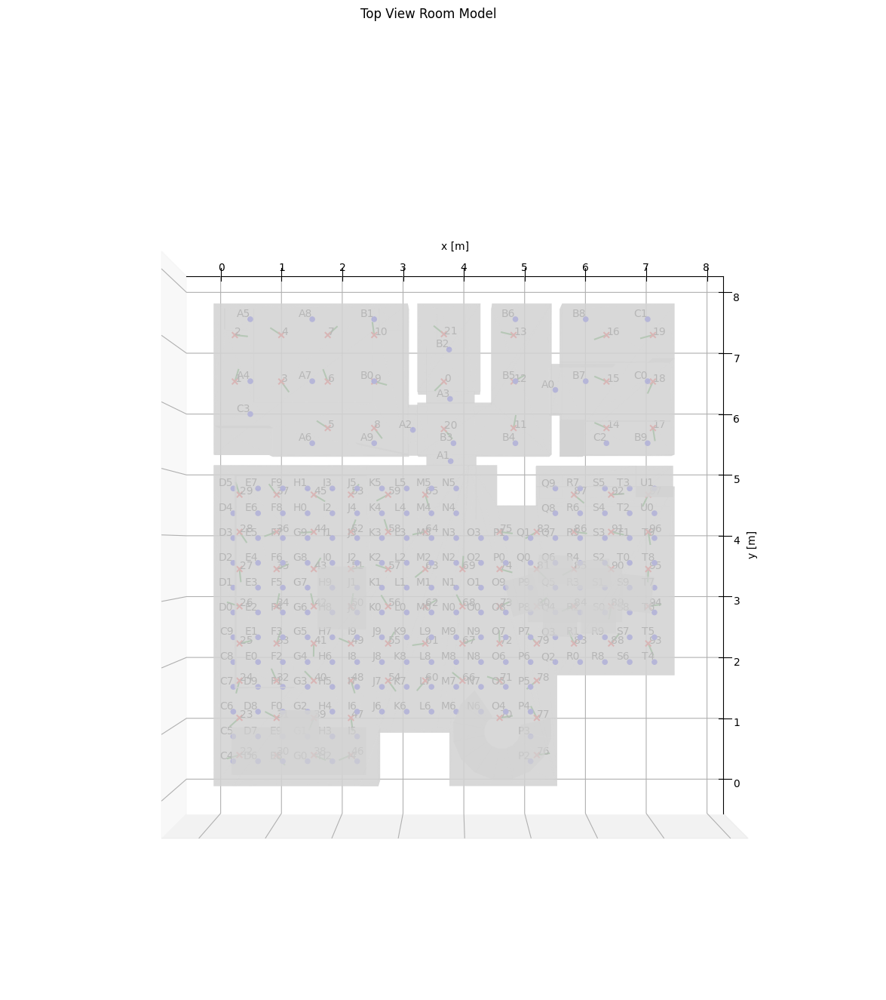

In [12]:
ax = plot_3d_model(MODEL_3D)

# Add nodes to axis
positions = np.array([value['node_position'][0:3] for value in nodes.values()])
ax.scatter(positions[:,0], positions[:,1], positions[:,2], s=30, c='r', marker="x")
for node in nodes.values():
    x = node['node_position'][0]
    y = node['node_position'][1]
    z = node['node_position'][2]
    ax.text(x, y, z, zdir='x', s=str(node['node_id']))
    LENGTH = 0.2
    x_end = x + LENGTH * math.cos(node['node_orientation'])
    y_end = y + LENGTH * math.sin(node['node_orientation'])
    plt.plot([x, x_end], [y, y_end], z, c='g')
    # plt.text(x_end, y_end, f"{math.degrees(node['node_orientation'])}°")

# Add source positions to axis
positions = np.array([value['source_position'][0:3] for value in nodes[0]['src'].values()])
ax.scatter(positions[:,0], positions[:,1], positions[:,2], c='b', marker='o')
for value in nodes[0]['src'].values():
    ax.text(value['source_position'][0], value['source_position'][1], value['source_position'][2], value['src_id'], zdir='x', ha='right', va='bottom')
    # ax.text2D(value['source_position'][0], value['source_position'][1], value['src_id'], ha='right', va='bottom', transform=ax.transAxes)

# If notebook, show right away
if isnotebook():
    plt.show()
    plt.close()

### 3D View
This plot shows the 3D view of the room model with all receiver microphones (red cross) and all sources (blue dot). If you run this code locally, you can interactively change the view and zoom.

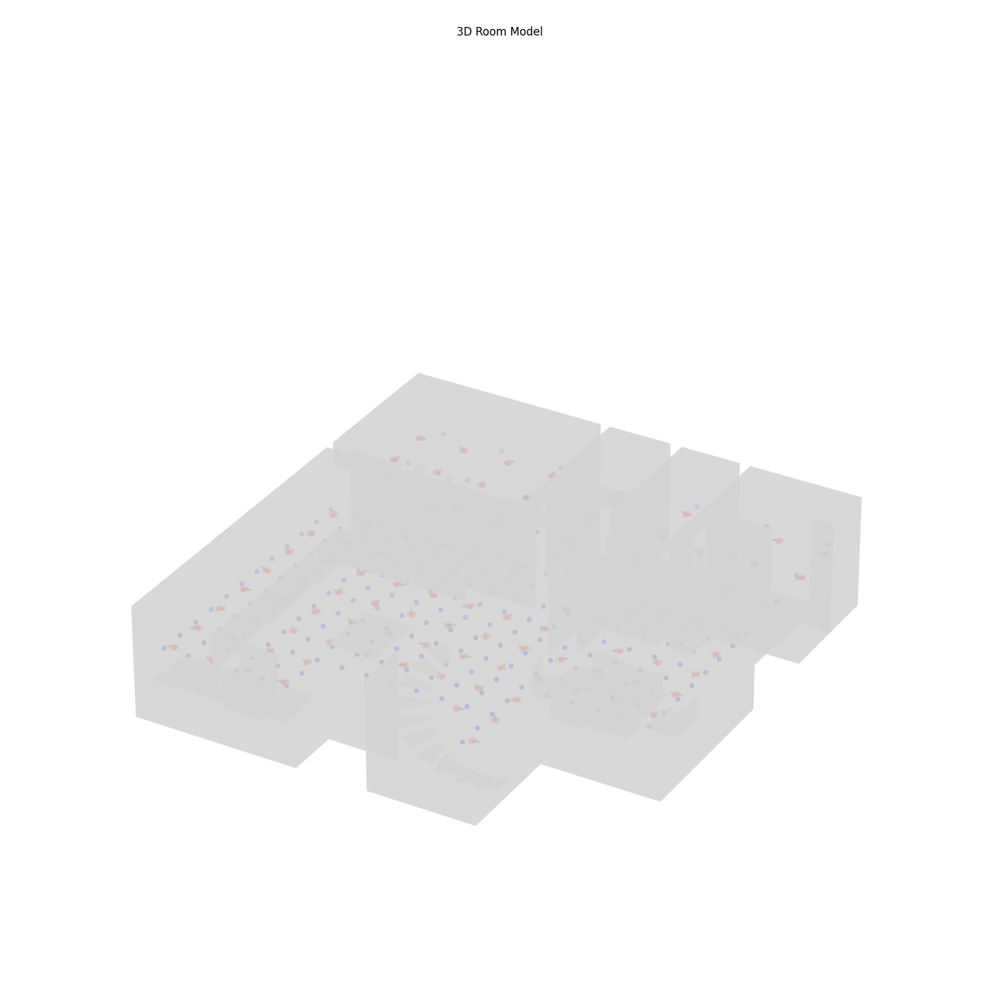

In [13]:
# This model can be interactive when run on your own system.
ax = plot_3d_model(MODEL_3D, dimention=3)

# Plot all microphones with array array aim
for node in nodes.values():
    ax.scatter(np.array(list(node['rec'].values()))[:,0], np.array(list(node['rec'].values()))[:,1], np.array(list(node['rec'].values()))[:,2], c='r', marker='x')
    x = node['node_position'][0]
    y = node['node_position'][1]
    z = node['node_position'][2]
    LENGTH = 0.1
    x_end = x + LENGTH * math.cos(node['node_orientation'])
    y_end = y + LENGTH * math.sin(node['node_orientation'])
    ax.plot([x, x_end], [y, y_end], z, c='g')
    # plt.text3D(x, y, z, node['node_id'])

# Plot all sources
positions = np.array([value['source_position'][0:3] for value in nodes[0]['src'].values()])
ax.scatter(positions[:,0], positions[:,1], positions[:,2], c='b', marker='o')

# If notebook, show right away
plt.axis('off')
if isnotebook():
    plt.show()
    plt.close()

## Data loading functions

In [14]:
def get_pos_pair_node(rec_pos, src_pos):
    """Get IDs of closest receiver and source pair for specific positions.

    Args:
        rec_pos (list): 3D coordinates of target receiver node position.
        src_pos (list): 3D coordinates of target source position.

    Returns:
        (int,int): IDs of receiver node and source closest to the positions.
    """
    # Use the global node dictionary
    global nodes

    # Find closest receiver node
    min_distance = np.inf
    min_node = -1
    for key, value in nodes.items():
        distance = np.linalg.norm(np.array(value['node_position'])-np.array(rec_pos))
        if distance < min_distance:
            min_distance = distance
            min_node = key
    
    # Find closest source
    min_distance = np.inf
    min_src = -1
    for key, value in nodes[min_node]['src'].items():
        distance = np.linalg.norm(np.array(value['source_position'])-np.array(src_pos))
        if distance < min_distance:
            min_distance = distance
            min_src = key
    
    return min_node, min_src

def get_rirs_node(rec_id, src_id, fs=None):
    """Get RIRs for source/receiver pair by IDs

    Args:
        rec_id (int): Index of node in dictionary
        src_id (int): Index of source in dictionary
        fs (int, optional): Target samplerate for resampling. If none given, the original one is used. Defaults to None.

    Returns:
        [list]: List containing RIR time signals of all microphones belonging to receiver node.
    """
    global nodes
    return [load_audio(file_path, fs=fs) for file_path in nodes[rec_id]['src'][src_id]['rir_paths'].values()]

In [15]:
def load_audio(file_path, fs=None):
    """Loads audio from filepath
    Suppors .WAV, .BIN (32-bit, little endian, 44.1 kHz), and .MAT with specific format.

    Args:
        file_path (string): Path to audio file
        fs (int, optional): Target samplerate for resampling. If none given, the original one is used. Defaults to None.

    Returns:
        torch.FloatTensor: Time signals as Tensor
    """

    # Check if file is WAV
    if file_path.upper().endswith('.WAV'):
        logging.debug('Using WAV file')
        # Load with range [-1,1]
        wav, _sr = torchaudio.load(file_path, normalize=True)

        # To mono
        wav = torch.mean(wav, 0)

        # If target sample rate given, resample
        if fs is not None:
            resample = nn.Sequential(
                    torchaudio.transforms.Resample(orig_freq=_sr, new_freq=fs)
                ).to(DEVICE)
            wav = resample(wav.to(DEVICE))
    # Check if file is Binary
    elif file_path.upper().endswith('.BIN'):
        logging.debug('Using Binary file')
        # Open binary file as 32 bit single-precision floating point number using little endian
        f = open(file_path, 'rb')
        data = np.fromfile(f, '<f4')
        f.close()
        # If target sample rate given, resample
        if fs is not None:
            # Original sample rate is hardcoded
            num = round(len(data) * (fs/44100))
            data = scipy.signal.resample(data, num)
        # Convert to PyTorch Tensor
        wav = torch.from_numpy(data).type(torch.FloatTensor)
    # Check if file is MATLAB File
    elif file_path.upper().endswith('.MAT'):
        logging.debug('Using MATLAB file')
        # Load MATLAB file containing IR
        ir_data = scipy.io.loadmat(file_path)
        # Get original sampling rate
        _sr = int(ir_data['TUCT_fs'])
        # Get the IR's name
        ir_name = 'h_%s' % '_'.join(os.path.basename(file_path).split('.')[-2].split('_')[-3:])
        # Get 
        wav = ir_data[ir_name]

        # If not mono
        if wav.ndim > 1 and wav.shape[0] > 1:
            wav = np.expand_dims(librosa.to_mono(wav), axis=0)
        elif wav.ndim > 1 and wav.shape[0] <= 1:
            wav = np.squeeze(wav)

        # If target sample rate given, resample
        if fs is not None:
            num = round(len(wav) * (fs/_sr))
            wav = scipy.signal.resample(wav, num)

        # Convert to PyTorch Tensor
        wav = torch.from_numpy(wav).type(torch.FloatTensor)

    return wav.to(DEVICE)

def convolve(wav, ir):
    # Convolve using PyTorch
    a1 = wav.view(1, 1, -1).to(DEVICE) # Utterance with correct dimension for convolution
    b1 = torch.flip(ir, (0,)).view(1, 1, -1).to(DEVICE)  # IR with correct dimension for convolution
    wav = torch.nn.functional.conv1d(a1, b1, padding=len(ir,)-1).view(-1) # Convolution

    return wav

def padding(wav, length):
    # Length correction using PyTorch
    if wav.shape[0] < length:
        diff = torch.tensor((length-wav.shape[0])/2, dtype=torch.int, device=DEVICE)
        pad = [int(diff), int(diff+1)]
        wav = torch.nn.functional.pad(wav, pad, mode='constant')
    
    return wav[:length]

In [16]:
def analyze_audio(audio, fs=None):
    """Creates time domain and spectrogram plot of signal

    Args:
        audio (torch.FloatTensor): Input audio Tensor
        fs (int, optional): Audio sample rate. Defaults to None.
    """
    # Tensor to numpy array
    y = audio.cpu().numpy()

    # Plot time signal
    fig = plt.figure(figsize=(14, 5))
    librosa.display.waveplot(y, sr=fs)
    plt.title('Time domain signal')
    if isnotebook():
        plt.show()
        plt.close()

    # Plot spectrogram
    fig = plt.figure(figsize=(14, 5))
    hop_length = 1024
    y_fft = librosa.stft(y, hop_length=hop_length, n_fft=2*hop_length)
    y_fft_db = librosa.amplitude_to_db(np.abs(y_fft), ref=np.max)
    librosa.display.specshow(y_fft_db, x_axis='time', y_axis='log', sr=fs, hop_length=hop_length)

    plt.colorbar(format='%+2.0f dB')
    plt.title('Log-frequency power spectrogram')
    if isnotebook():
        plt.show()
        plt.close()

## Example RIR comparison
### Example RIR between two positions of first example
Here, two positions are given. ```get_pos_pair_node``` returns the IDs of the node and source being closest to the positions.
```get_rirs_node``` returns all 4 IRs of the receiver node combination. The first IR is then used for plotting and convolving with a clean speech sample.

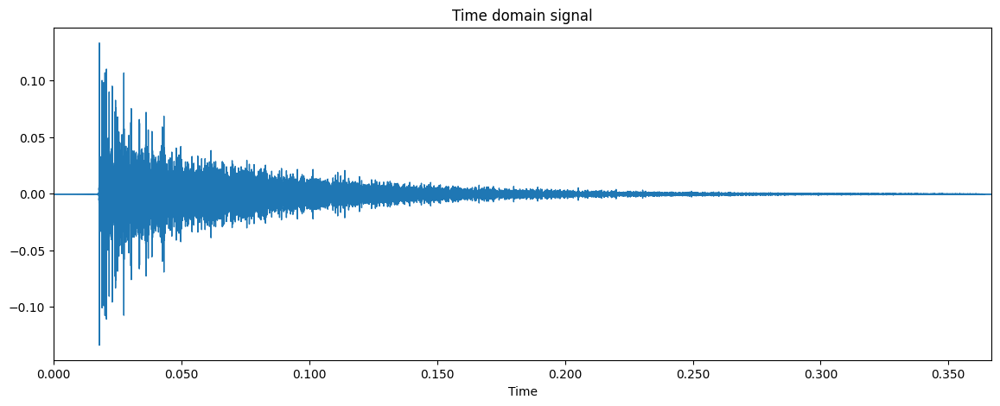

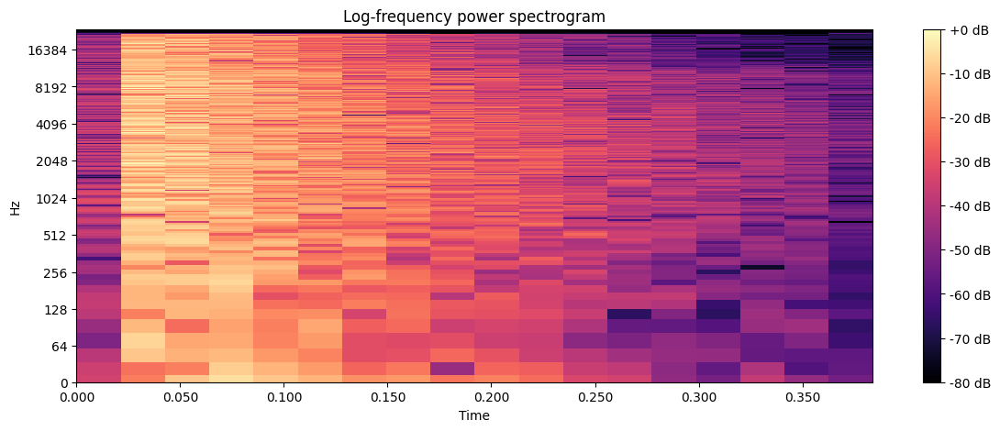

In [17]:
# Search for source and receiver close to this positions
rec_pos = [6.9, 3.8, 1.3]
src_pos = [1.1, 3.2, 1.3]
rec_id, src_id = get_pos_pair_node(rec_pos, src_pos)
# Get RIR from IDs
irs = get_rirs_node(rec_id, src_id, fs=FS)

# Use only microphone 0 of chosen node
ir = irs[0]

# Plot time signal and spectrogram of RIR
analyze_audio(ir, fs=FS)

# Load sample speech file
wav = load_audio(CLEAN_AUDIO, fs=FS)
# Convolve speech with RIR
audio = convolve(wav, ir)
# Display result in notebook
ipd.Audio(data=audio.cpu().numpy(), rate=FS, normalize=True)

### Example RIR position plot of first example
This plot shows the top view of the model with the defined positions in orange, the selected node in red, as well as the selected source in blue.
The green line illustrates the direct path of the RIR.

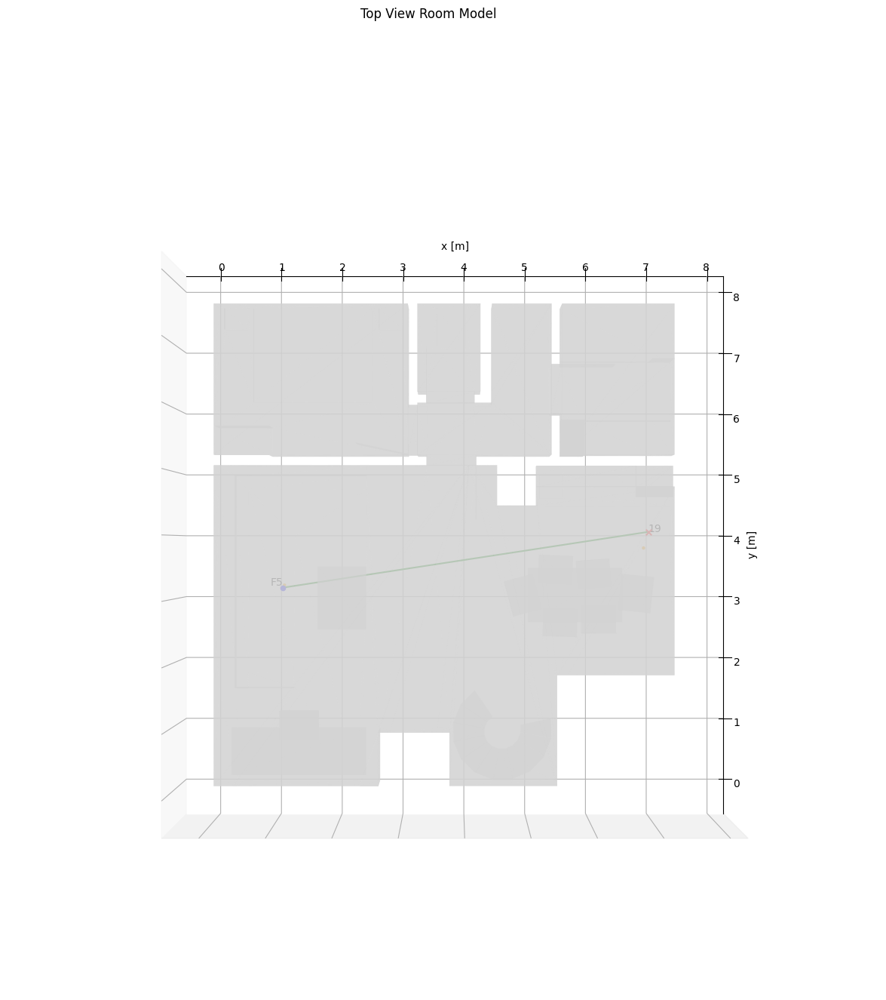

In [18]:
ax = plot_3d_model(MODEL_3D)

# Node Positions
positions = np.array([nodes[rec_id]['node_position']])
ax.scatter(positions[0,0], positions[0,1], positions[0,2], s=30, c='r', marker="x")
ax.text(positions[0][0], positions[0][1], positions[0][2], zdir='x', s=str(node['node_id']))

# Source Positions
positions = np.append(positions, np.array([nodes[rec_id]['src'][src_id]['source_position']]), axis=0)
ax.scatter(positions[1,0], positions[1,1], positions[1,2], c='b', marker='o')
ax.text(positions[1][0], positions[1][1], positions[1][2], nodes[rec_id]['src'][src_id]['src_id'], zdir='x', ha='right', va='bottom')

plt.plot(positions[:,0], positions[:,1], positions[:,2], c='g')

ax.scatter(np.array([rec_pos, src_pos])[:,0], np.array([rec_pos, src_pos])[:,1], np.array([rec_pos, src_pos])[:,2], c='orange', marker='.')

if isnotebook():
    plt.show()
    plt.close()

### Example RIR between two positions of second example
Here, two positions are given. ```get_pos_pair_node``` returns the IDs of the node and source being closest to the positions.
```get_rirs_node``` returns all 4 IRs of the receiver node combination. The first IR is then used for plotting and convolving with a clean speech sample.

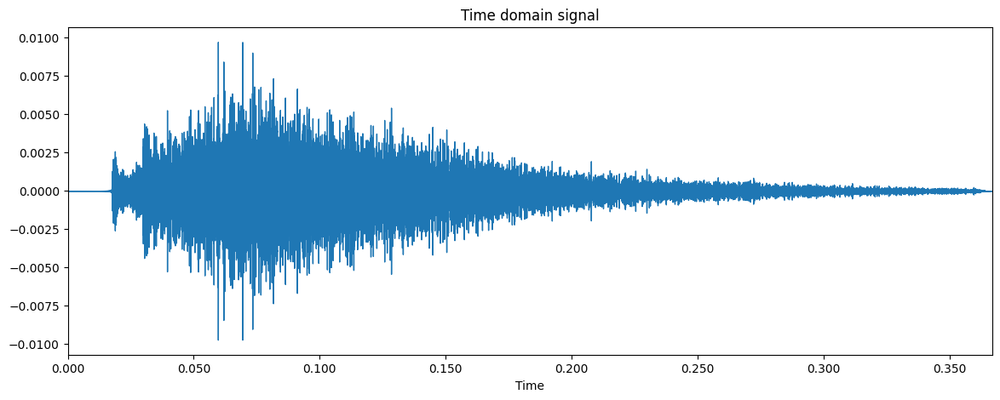

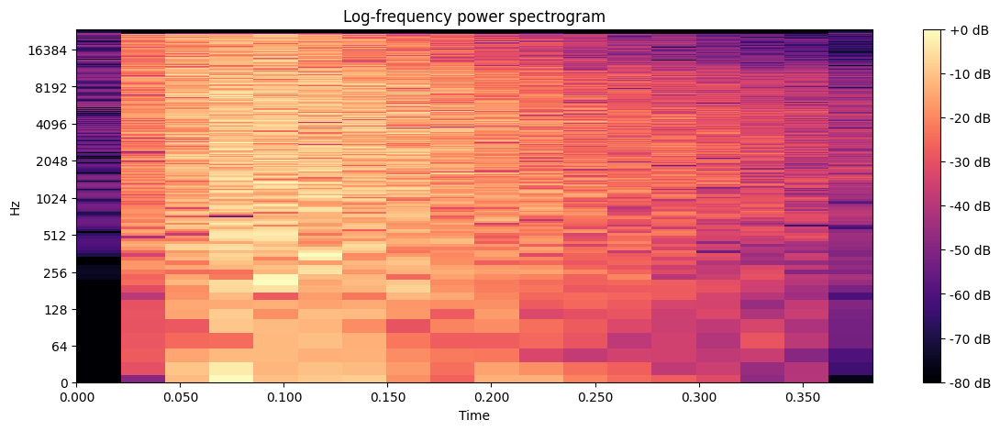

In [19]:
# Search for source and receiver close to this positions
rec_pos = [6.9, 3.8, 1.3]
src_pos = [1.1, 6.5, 1.3]
rec_id, src_id = get_pos_pair_node(rec_pos, src_pos)
# Get RIR from IDs
irs = get_rirs_node(rec_id, src_id, fs=FS)

# Use only microphone 0 of chosen node
ir = irs[0]

# Plot time signal and spectrogram of RIR
analyze_audio(ir, fs=FS)

# Load sample speech file
wav = load_audio(CLEAN_AUDIO, fs=FS)
# Convolve speech with RIR
audio = convolve(wav, ir)
# Display result in notebook
ipd.Audio(data=audio.cpu().numpy(), rate=FS, normalize=False)

### Example RIR position plot of second example
This plot shows the top view of the model with the defined positions in orange, the selected node in red, as well as the selected source in blue.
The green line illustrates the direct path of the RIR.

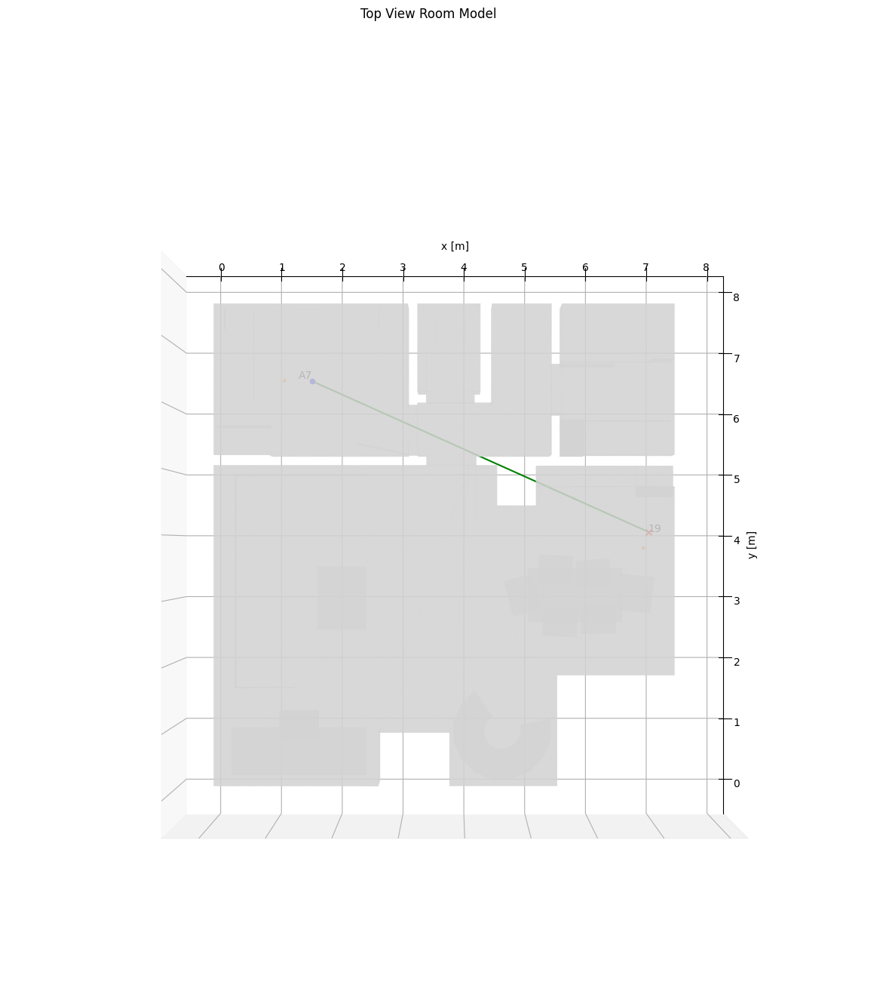

In [20]:
ax = plot_3d_model(MODEL_3D)

# Node Positions
positions = np.array([nodes[rec_id]['node_position']])
ax.scatter(positions[0,0], positions[0,1], positions[0,2], s=30, c='r', marker="x")
ax.text(positions[0][0], positions[0][1], positions[0][2], zdir='x', s=str(node['node_id']))

# Source Positions
positions = np.append(positions, np.array([nodes[rec_id]['src'][src_id]['source_position']]), axis=0)
ax.scatter(positions[1,0], positions[1,1], positions[1,2], c='b', marker='o')
ax.text(positions[1][0], positions[1][1], positions[1][2], nodes[rec_id]['src'][src_id]['src_id'], zdir='x', ha='right', va='bottom')

plt.plot(positions[:,0], positions[:,1], positions[:,2], c='g')

ax.scatter(np.array([rec_pos, src_pos])[:,0], np.array([rec_pos, src_pos])[:,1], np.array([rec_pos, src_pos])[:,2], c='orange', marker='.')

if isnotebook():
    plt.show()
    plt.close()

## Load all files
This example code shows how to iterate over all RIRs.

In [21]:
# Example of how to iterate over all RIR in the dataset
count = 0
for node in tqdm(nodes.values()):
    for src in node['src'].values():
        for mic in src['rir_paths'].values():
            try:
                # load_audio(mic, fs=FS)
                count = count + 1
            except Exception as e:
                logger.error(f'Failed to load: {mic}')
                logger.error(e)

n_src = len(nodes[0]['src'])
n_rir_expected = len(nodes) * 4 * n_src
logger.info(f'Loaded {count}/{n_rir_expected} RIRs')

  0%|          | 0/98 [00:00<?, ?it/s]

INFO     Loaded 79184/79184 RIRs


## Finish notebook

In [22]:
if not isnotebook():
    plt.show()
    plt.close()
# Save Notebook as HTML
# ! jupyter nbconvert --to html load_database.ipynb

# Save Notebook:
# Ctrl+Shift+P
# Jupyter: Export Current Python File as Jupyter Notebook: